In [301]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import dash
from dash import html
from dash import dcc
from sklearn.preprocessing import MinMaxScaler
from statsmodels.tsa.seasonal import seasonal_decompose


## DATAFRAMES

In [302]:
df_covid = pd.read_csv('Data/covid-data.csv', delimiter=',')
df_eco_covid = pd.read_csv('Data/data_econo_covid.csv', delimiter=';')
df_education = pd.read_csv('Data/Education-GDP.csv', delimiter=',')
df_GDP = pd.read_csv('Data/GDP.csv', delimiter=',')
df_gini = pd.read_csv('Data/gini.csv', delimiter=',')
df_poverty = pd.read_csv('Data/poverty-explorer.csv', delimiter=',')
df_trade = pd.read_csv('Data/trade.csv', delimiter=',')
df_HICP_FR = pd.read_csv('Data/HICP_FR.csv', delimiter=',') #The Harmonized Consumer Price Index (HICP) provides a standardized measure of inflation across EU countries.
df_HICP_BE = pd.read_csv('Data/HICP_BE.csv', delimiter=',')
df_HICP_BU_21 = pd.read_csv('Data/HICP_BU_21.csv', delimiter=',')
df_HICP_FI = pd.read_csv('Data/HICP_FI.csv', delimiter=',')
df_HICP_food_europe = pd.read_csv('Data/HICP_food_europe.csv', delimiter=',')
df_HICP_GR = pd.read_csv('Data/HICP_GR.csv', delimiter=',')
df_HICP_nrj_BU = pd.read_csv('Data/HICP_nrj_BU.csv', delimiter=',')
df_HICP_nrj_GE = pd.read_csv('Data/HICP_nrj_GE.csv', delimiter=',')
df_HICP_nrj_GR = pd.read_csv('Data/HICP_nrj_GR.csv', delimiter=',')
df_HICP_nrj_IT = pd.read_csv('Data/HICP_nrj_IT.csv', delimiter=',')
df_HICP_PO = pd.read_csv('Data/HICP_PO.csv', delimiter=',') 
df_HICP_RO = pd.read_csv('Data/HICP_RO.csv', delimiter=',')
df_HICP_HU = pd.read_csv('Data/HICP_HU.csv', delimiter=',')


## Exploration df_covid

### Preselection of rows and columns

In [304]:
df_covid['iso_code'].value_counts().sort_values(ascending=False).head()

iso_code
MEX    1526
ARG    1526
AUT    1524
VGB    1524
BRA    1524
Name: count, dtype: int64

In [305]:
df_covid['iso_code'].value_counts().sort_values(ascending=True).head(10)

iso_code
ESH            1
OWID_CYN     691
MAC          795
OWID_WLS    1198
OWID_SCT    1305
TWN         1348
OWID_ENG    1359
OWID_NIR    1372
HKG         1491
AUS         1524
Name: count, dtype: int64

Removing countries with less than 1524 values:

In [306]:
print("Before removal:")
print(df_covid['iso_code'].value_counts(ascending=True))

countries_to_remove = ['ESH', 'OWID_CYN', 'MAC', 'OWID_WLS', 'OWID_SCT', 'TWN', 'OWID_ENG', 'OWID_NIR', 'HKG']

df_covid = df_covid[~df_covid['iso_code'].isin(countries_to_remove)]

print("\nAfter removal:")
print(df_covid['iso_code'].value_counts(ascending=True))

Before removal:
iso_code
ESH            1
OWID_CYN     691
MAC          795
OWID_WLS    1198
OWID_SCT    1305
            ... 
DEU         1524
GEO         1524
GRL         1524
ARG         1526
MEX         1526
Name: count, Length: 255, dtype: int64

After removal:
iso_code
AFG         1524
NER         1524
NGA         1524
NIU         1524
OWID_NAM    1524
            ... 
GTM         1524
PYF         1524
ZWE         1524
MEX         1526
ARG         1526
Name: count, Length: 246, dtype: int64


In [307]:
df_covid['iso_code'].value_counts().sort_values(ascending=True).head(10)

iso_code
OWID_LIC    1524
BRA         1524
ALB         1524
DZA         1524
ASM         1524
AND         1524
AGO         1524
AIA         1524
ATG         1524
ARM         1524
Name: count, dtype: int64

Selecting interesting variables and countries of the european continent.

In [308]:
df_covid_europe = df_covid[df_covid['continent'] == 'Europe']
df_covid_europe


,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,population,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
3048,ALB,Europe,Albania,2020-01-03,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3049,ALB,Europe,Albania,2020-01-04,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3050,ALB,Europe,Albania,2020-01-05,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3051,ALB,Europe,Albania,2020-01-06,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
3052,ALB,Europe,Albania,2020-01-07,NaN,0.0,NaN,NaN,0.0,NaN,...,51.2,NaN,2.89,78.57,0.795,2842318.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372596,VAT,Europe,Vatican,2024-03-01,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN
372597,VAT,Europe,Vatican,2024-03-02,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN
372598,VAT,Europe,Vatican,2024-03-03,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN
372599,VAT,Europe,Vatican,2024-03-04,26.0,0.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,75.12,NaN,808.0,NaN,NaN,NaN,NaN


In [309]:
df_covid_europe = df_covid_europe[['iso_code','new_cases_smoothed_per_million', 'location', 'date', 'total_cases', 'total_cases_per_million', 'total_deaths', 'total_deaths_per_million', 'human_development_index', 'population', 'excess_mortality_cumulative_per_million','positive_rate', 'people_vaccinated_per_hundred', 'stringency_index', 'population_density', 'median_age', 'new_deaths_per_million']]
df_covid_europe.head()

,iso_code,new_cases_smoothed_per_million,location,date,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,human_development_index,population,excess_mortality_cumulative_per_million,positive_rate,people_vaccinated_per_hundred,stringency_index,population_density,median_age,new_deaths_per_million
3048,ALB,NaN,Albania,2020-01-03,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3049,ALB,NaN,Albania,2020-01-04,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3050,ALB,NaN,Albania,2020-01-05,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3051,ALB,NaN,Albania,2020-01-06,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3052,ALB,NaN,Albania,2020-01-07,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0


### Construction of graphs (Covid related)

Look if certain groups of countries stand out according to different criterias

#### Total Cases

In [310]:
#Plot Total Cases

import plotly.express as px

fig = px.line(
    df_covid_europe,
    x='date',
    y='total_cases',
    color='location',
    title='Total COVID-19 Cases Over Time in European Countries',
    labels={'total_cases': 'Total Cases', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Cases',
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



#### Total deaths, total deaths per million or excess mortality cumulative per million

 excess_mortality_cumulative_per_million could be more interesting than total_deaths because it takes into consideration the 'usual' death ratio of the country as well as its population size. We can see with the following graphs that the countries with the highest values are not the same depending on if the criteria "per million" was taken or not. 
excess_mortality_cumulative_per_million and total_deaths look quite similar for most countries, and we have more data for total_deaths so we could choose total_deaths for our analysis.
Let's select "total_deaths", "excess_mortality_cumulative_per_million", "stringency_index", "total_cases_per_million" for now.

In [311]:
# Plot Total Deaths

import plotly.express as px

fig = px.line(
    df_covid_europe,
    x='date',
    y='total_deaths',
    color='location',
    title='Total Deaths Over Time in European Countries',
    labels={'total_deaths': 'Total Deaths', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Deaths',
)

fig.show()

/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [312]:
# Plot Total Deaths per million

import plotly.express as px

fig = px.line(
    df_covid_europe,
    x='date',
    y='total_deaths_per_million',
    color='location',
    title='Total Deaths (per million) Over Time in European Countries',
    labels={'total_deaths_per_million': 'Total Deaths', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Deaths per million',
)

fig.show()

/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [313]:

df_covid_europe_copy = df_covid_europe.copy()

In [314]:
# Plot Excess mortality cumulative per million

## Fill NaN values with the weekly average
df_covid_europe_copy['excess_mortality_cumulative_per_million'] = (
    df_covid_europe_copy.groupby('location')['excess_mortality_cumulative_per_million']
    .transform(lambda x: x.fillna(x.rolling(7, min_periods=1).mean()))
)

fig = px.line(
    df_covid_europe_copy,
    x='date',
    y='excess_mortality_cumulative_per_million',
    color='location',
    title='Excess Mortality (cumulative per million) Over Time in European Countries',
    labels={'excess_mortality_cumulative_per_million': 'Excess mortality', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Excess mortality',
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Sort countries based on their excess_mortality_cumulative_per_million and total_deaths_per_million values on the 01.01.2024:

In [315]:
df_snapshot_2024 = df_covid_europe_copy[df_covid_europe_copy['date'] == '2024-01-01'].copy()

df_snapshot_2024.loc[:, 'rank_excess_mortality'] = df_snapshot_2024['excess_mortality_cumulative_per_million'].rank(ascending=False)

df_snapshot_2024.loc[:, 'rank_total_deaths'] = df_snapshot_2024['total_deaths_per_million'].rank(ascending=False)

df_snapshot_2024.loc[:, 'rank_stringency_index'] = df_snapshot_2024['stringency_index'].rank(ascending=False)  # just curiosity

result_table = df_snapshot_2024[['location', 'rank_excess_mortality', 'rank_total_deaths', 'stringency_index']].sort_values(by='rank_excess_mortality')

result_table

,location,rank_excess_mortality,rank_total_deaths,stringency_index
193287,Lithuania,1.0,14.0,NaN
51753,Bulgaria,2.0,1.0,NaN
250472,North Macedonia,3.0,4.0,NaN
79185,Croatia,4.0,6.0,NaN
184143,Latvia,5.0,9.0,NaN
313276,Slovakia,6.0,10.0,NaN
281491,Romania,7.0,15.0,NaN
165855,Italy,8.0,18.0,NaN
85281,Czechia,9.0,8.0,NaN
152139,Hungary,10.0,3.0,NaN


Sort countries based on their excess_mortality_cumulative_per_million and total_deaths_per_million values on the 01.01.2022:

In [316]:
df_snapshot_2024b = df_covid_europe_copy[df_covid_europe_copy['date'] == '2022-01-01'].copy()

df_snapshot_2024b.loc[:, 'rank_excess_mortality'] = df_snapshot_2024b['excess_mortality_cumulative_per_million'].rank(ascending=False)

df_snapshot_2024b.loc[:, 'rank_total_deaths'] = df_snapshot_2024b['total_deaths_per_million'].rank(ascending=False)

df_snapshot_2024b.loc[:, 'rank_stringency_index'] = df_snapshot_2024b['stringency_index'].rank(ascending=False)  # just curiosity

result_table = df_snapshot_2024b[['location', 'rank_excess_mortality', 'rank_total_deaths', 'rank_stringency_index']].sort_values(by='rank_excess_mortality')

result_table

,location,rank_excess_mortality,rank_total_deaths,rank_stringency_index
51023,Bulgaria,1.0,1.0,17.0
282285,Russia,2.0,21.0,10.0
304926,Serbia,3.0,27.0,42.0
249742,North Macedonia,4.0,3.0,NaN
192557,Lithuania,5.0,14.0,43.0
43403,Bosnia and Herzegovina,6.0,2.0,36.0
280761,Romania,7.0,10.0,4.5
3777,Albania,8.0,37.0,16.0
219262,Moldova,9.0,7.0,23.0
223834,Montenegro,10.0,5.0,NaN


#### Stringency index

In [317]:
fig = px.line(
    df_covid_europe,
    x='date',
    y='stringency_index',
    color='location',
    title='stringency index Over Time in European Countries',
    labels={'stringency_index': 'Stringency Index', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Stringency Index',
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [318]:
# Select the countries of interest
selected_countries = ['France', 'Germany', 'Italy', 'Greece', 'Norway']

# Filter the DataFrame for the selected countries
df_covid_europe_5countries = df_covid_europe_copy[df_covid_europe_copy['location'].isin(selected_countries)]

In [319]:
# stringency index vs total cases

fig = go.Figure()

for country in selected_countries:
    country_data = df_covid_europe_5countries[df_covid_europe_5countries['location'] == country]
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['total_cases'],
        mode='lines',
        name=f'Total Cases - {country}',
    ))
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['stringency_index'],
        mode='lines',
        name=f'Stringency Index - {country}',
        yaxis='y2',
    ))

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Cases',
    yaxis2=dict(title='Stringency Index', overlaying='y', side='right'),
    title='Total Cases and Stringency Index Over Time for Selected Countries',
    showlegend=True,
)

fig.show()


In [320]:

# Normalize total cases
scaler_total_cases = MinMaxScaler()
df_covid_europe_5countries['normalized_total_cases'] = scaler_total_cases.fit_transform(df_covid_europe_5countries['total_cases'].values.reshape(-1, 1))

# Normalize stringency index
scaler_stringency_index = MinMaxScaler()
df_covid_europe_5countries['normalized_stringency_index'] = scaler_stringency_index.fit_transform(df_covid_europe_5countries['stringency_index'].values.reshape(-1, 1))

# Create subplots
fig = make_subplots(rows=len(selected_countries), cols=1, shared_xaxes=True, subplot_titles=selected_countries)

# Add traces for each country
for i, country in enumerate(selected_countries, 1):
    country_data = df_covid_europe_5countries[df_covid_europe_5countries['location'] == country]
    
    # Add normalized total cases trace
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['normalized_total_cases'],
        mode='lines+markers',
        name=f'Normalized Total Cases - {country}',
    ), row=i, col=1)
    
    # Add normalized stringency index trace
    fig.add_trace(go.Scatter(
        x=country_data['date'],
        y=country_data['normalized_stringency_index'],
        mode='lines+markers',
        name=f'Normalized Stringency Index - {country}',
        yaxis='y2',
    ), row=i, col=1)

    # Update layout to add secondary y-axis
    fig.update_layout(
        yaxis2=dict(
            title='Normalized Stringency Index',
            overlaying='y',
            side='right',
        ),
    )

# Update layout
fig.update_layout(
    height=2000,
    showlegend=True,
    title_text='Normalized Total Cases and Stringency Index Over Time for Selected Countries',
)

fig.update_xaxes(title_text='Date', row=len(selected_countries), col=1)
fig.update_yaxes(title_text='Normalized Total Cases', row=(len(selected_countries) + 1) // 2, col=1)

fig.show()


/tmp/ipykernel_7616/97932361.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_7616/97932361.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



### Construction of graphs (demographic-economic)

#### Filter countries without data

In [321]:
df_missing_data = df_covid_europe.groupby('location').agg({
    'population': 'mean',
    'population_density': 'mean',
    'median_age': 'mean',
    'human_development_index': 'mean'
}).reset_index()

df_missing_data = df_missing_data[df_missing_data[['population', 'population_density', 'median_age', 'human_development_index']].isnull().any(axis=1)]

missing_data_location = df_missing_data['location'].tolist()
missing_data_location

['Andorra',
 'Faeroe Islands',
 'Gibraltar',
 'Guernsey',
 'Isle of Man',
 'Jersey',
 'Kosovo',
 'Liechtenstein',
 'Monaco',
 'San Marino',
 'Vatican']

In [322]:
df_covid_europe_filtered = df_covid_europe[~df_covid_europe['location'].isin(missing_data_location)]
df_covid_europe_filtered

,iso_code,new_cases_smoothed_per_million,location,date,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,human_development_index,population,excess_mortality_cumulative_per_million,positive_rate,people_vaccinated_per_hundred,stringency_index,population_density,median_age,new_deaths_per_million
3048,ALB,NaN,Albania,2020-01-03,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3049,ALB,NaN,Albania,2020-01-04,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3050,ALB,NaN,Albania,2020-01-05,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3051,ALB,NaN,Albania,2020-01-06,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
3052,ALB,NaN,Albania,2020-01-07,NaN,NaN,NaN,NaN,0.795,2842318.0,NaN,NaN,NaN,0.0,104.871,38.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
361928,GBR,0.0,United Kingdom,2024-03-01,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8,0.0
361929,GBR,0.0,United Kingdom,2024-03-02,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8,0.0
361930,GBR,0.0,United Kingdom,2024-03-03,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8,0.0
361931,GBR,0.0,United Kingdom,2024-03-04,24905351.0,368919.324,232112.0,3438.241,0.932,67508936.0,NaN,NaN,NaN,NaN,272.898,40.8,0.0


#### Plot Human development index

In [323]:
df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['human_development_index'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='human_development_index')

color_scale = [
    (0, 'yellow'),        
    (0.25, 'orange'),     
    (0.5, 'red'),         
    (0.75, 'purple'),     
    (1, 'purple')         
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='human_development_index',
    title='Human Development Index of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'human_development_index': 'Human development index', 'location': 'European Countries'},
    color='human_development_index',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Human development index',
)

fig.show()


#### Plot population

In [324]:
df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['population'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='population')

color_scale = [
    (0, 'yellow'),        # Very low population density
    (0.25, 'orange'),     # Low-median
    (0.5, 'red'),         # Median-high
    (0.75, 'purple'),     # Very high population density
    (1, 'purple')         # Very high population density
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='population',
    title='population of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'population': 'population', 'location': 'European Countries'},
    color='population',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='population',
)

fig.show()


#### Plot population_density

In [325]:
df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['population_density'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='population_density')

color_scale = [
    (0, 'yellow'),        # Very low population density
    (0.25, 'orange'),     # Low-median
    (0.5, 'red'),         # Median-high
    (0.75, 'purple'),     # Very high population density
    (1, 'purple')         # Very high population density
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='population_density',
    title='Population density of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'population_density': 'Population density', 'location': 'European Countries'},
    color='population_density',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Population density',
)

fig.show()

#### Plot median_age

In [326]:
df_covid_europe_grouped = df_covid_europe_filtered.groupby('location')['median_age'].mean().reset_index()
df_covid_europe_grouped = df_covid_europe_grouped.sort_values(by='median_age')

color_scale = [
    (0, 'yellow'),        # Very low population density
    (0.25, 'orange'),     # Low-median
    (0.5, 'red'),         # Median-high
    (0.75, 'purple'),     # Very high population density
    (1, 'purple')         # Very high population density
]


fig = px.bar(
    df_covid_europe_grouped,
    x='location',
    y='median_age',
    title='Median Age of European Countries (Excluding Monaco, Gibraltar, Malta)',
    labels={'populatmedian_ageion_density': 'Median Age', 'location': 'European Countries'},
    color='median_age',
    color_continuous_scale=color_scale
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Median age',
)

fig.show()

In [327]:
import plotly.express as px

fig = px.violin(
    df_covid_europe_grouped,
    y='median_age',
    box=True,  # Include box plot inside the violin
    points="all",  # Display individual data points
    title='Distribution of Median Age in European Countries',
    labels={'median_age': 'Median Age', 'location': 'European Countries'},
)

fig.update_layout(
    xaxis_title='European Countries',
    yaxis_title='Median Age',
)

fig.show()


#### Plot human_development_index with other variables

In [328]:
fig = px.scatter(
    df_covid_europe_filtered,
    x='human_development_index',
    y='population_density',
    title='Relation Between Population density and Human Development Index',
    labels={'human_development_index': 'Human Development Index', 'population_density': 'population_density'},
    hover_data=['location'],  # Display country names on hover
)

fig.update_layout(
    xaxis_title='Human Development Index',
    yaxis_title='Population Density',
)

fig.show()


In [329]:
import plotly.express as px

columns_of_interest = ['location', 'date', 'total_deaths', 'human_development_index']

df_covid_economy_relation = df_covid_europe_5countries[columns_of_interest]

# Scale human development index values to the range of total_deaths_per_million

max_deaths_per_million = df_covid_economy_relation['total_deaths'].max()
df_covid_economy_relation['scaled_hd_index'] = (
    df_covid_economy_relation['human_development_index'] / df_covid_economy_relation['human_development_index'].max()
) * max_deaths_per_million

fig = px.line(
    df_covid_economy_relation,
    x='date',
    y='total_deaths',
    color='location',
    title='Relation Between Total Deaths and Scaled Human Development Index Over Time',
    labels={'total_deaths': 'Total Deaths', 'date': 'Date'},
    line_shape='linear',  
    hover_data=['location'], 
)

for country in df_covid_economy_relation['location'].unique():
    hd_index_scaled = df_covid_economy_relation[df_covid_economy_relation['location'] == country]['scaled_hd_index'].iloc[0]
    fig.add_shape(
        dict(
            type='line',
            x0=df_covid_economy_relation['date'].min(),
            x1=df_covid_economy_relation['date'].max(),
            y0=hd_index_scaled,
            y1=hd_index_scaled,
            line=dict(color='gray', width=2, dash='dash'),
            name=f'{country} Scaled Human Development Index',
        )
    )

fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Total Deaths',
)

fig.show()


/tmp/ipykernel_7616/2897196238.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [331]:
import plotly.express as px

columns_of_interest = ['location', 'date', 'total_deaths_per_million', 'human_development_index']

df_covid_economy_relation = df_covid_europe_5countries[columns_of_interest]

fig = px.scatter(
    df_covid_economy_relation,
    x='total_deaths_per_million',
    y='human_development_index',
    color='date',
    size_max=20,
    hover_data=['location'],
    title='Relation Between Total Deaths per Million and Human Development Index Across Countries',
    labels={'total_deaths_per_million': 'Total Deaths per Million', 'human_development_index': 'Human Development Index'},
)

fig.show()


/home/celine/anaconda3/envs/ml/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



Having only one value per country for the human development index, we could not see analyze anything with this feature. 

### Selection of features and countries

Having only one value per country, we can still identify groups of countries which are often close to each other according to those criterias:
Norway, Belgium/Finland, Greece/Italy, Bulgaria/Romania, France/Germany. This result is confirmed by the cluster_europe notebook.
Those countries represent well the diversity of the europe continent, also according to covid related graphs.
We should choose the ones which have the most data for the features we want to analyse.
We kept the features ['iso_code','location', 'date', 'total_deaths', 'stringency_index', 'total_cases_per_million', 'human_development_index', 'new_deaths_per_million, 'new_cases_smoothed_per_million', 'weekly_hosp_admissions_per_million']


In [332]:
# Select the countries of interest
selected_countries = ['Norway', 'Belgium', 'Finland', 'Greece', 'Italy', 'Bulgaria', 'France', 'Germany', 'Poland', 'Romania', 'Hungary']

# Filter the DataFrame for the selected countries
df_covid_europe_8countries = df_covid_europe[df_covid_europe['location'].isin(selected_countries)]

df_covid_europe_8countries

,iso_code,new_cases_smoothed_per_million,location,date,total_cases,total_cases_per_million,total_deaths,total_deaths_per_million,human_development_index,population,excess_mortality_cumulative_per_million,positive_rate,people_vaccinated_per_hundred,stringency_index,population_density,median_age,new_deaths_per_million
32006,BEL,NaN,Belgium,2020-01-03,1.0,0.086,NaN,NaN,0.931,11655923.0,NaN,NaN,NaN,0.0,375.564,41.8,0.0
32007,BEL,NaN,Belgium,2020-01-04,1.0,0.086,NaN,NaN,0.931,11655923.0,NaN,NaN,NaN,0.0,375.564,41.8,0.0
32008,BEL,NaN,Belgium,2020-01-05,1.0,0.086,NaN,NaN,0.931,11655923.0,-13.086293,NaN,NaN,0.0,375.564,41.8,0.0
32009,BEL,NaN,Belgium,2020-01-06,1.0,0.086,NaN,NaN,0.931,11655923.0,NaN,NaN,NaN,0.0,375.564,41.8,0.0
32010,BEL,NaN,Belgium,2020-01-07,1.0,0.086,NaN,NaN,0.931,11655923.0,NaN,NaN,NaN,0.0,375.564,41.8,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
281551,ROU,0.0,Romania,2024-03-01,3523438.0,179225.271,68697.0,3494.382,0.828,19659270.0,NaN,NaN,NaN,NaN,85.129,43.0,0.0
281552,ROU,0.0,Romania,2024-03-02,3523438.0,179225.271,68697.0,3494.382,0.828,19659270.0,NaN,NaN,NaN,NaN,85.129,43.0,0.0
281553,ROU,0.0,Romania,2024-03-03,3523438.0,179225.271,68697.0,3494.382,0.828,19659270.0,NaN,NaN,NaN,NaN,85.129,43.0,0.0
281554,ROU,0.0,Romania,2024-03-04,3523438.0,179225.271,68697.0,3494.382,0.828,19659270.0,NaN,NaN,NaN,NaN,85.129,43.0,0.0


In [333]:
# Select the features of interest
columns_of_interest = ['iso_code','location', 'date', 'total_deaths', 'stringency_index', 'total_cases_per_million', 'human_development_index', 'new_deaths_per_million', 'new_cases_smoothed_per_million', 'weekly_hosp_admissions_per_million']

# Filter the DataFrame for the selected columns and countries
df_covid_europe_8countries_4features = df_covid_europe_8countries[columns_of_interest]

df_covid_europe_8countries_4features

,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
32006,BEL,Belgium,2020-01-03,NaN,0.0,0.086,0.931,0.0
32007,BEL,Belgium,2020-01-04,NaN,0.0,0.086,0.931,0.0
32008,BEL,Belgium,2020-01-05,NaN,0.0,0.086,0.931,0.0
32009,BEL,Belgium,2020-01-06,NaN,0.0,0.086,0.931,0.0
32010,BEL,Belgium,2020-01-07,NaN,0.0,0.086,0.931,0.0
...,...,...,...,...,...,...,...,...
281551,ROU,Romania,2024-03-01,68697.0,NaN,179225.271,0.828,0.0
281552,ROU,Romania,2024-03-02,68697.0,NaN,179225.271,0.828,0.0
281553,ROU,Romania,2024-03-03,68697.0,NaN,179225.271,0.828,0.0
281554,ROU,Romania,2024-03-04,68697.0,NaN,179225.271,0.828,0.0


### Clean Stringency index

We can find missing values for the stringency index features only after 2023. There were no more stringency measures at this time so we decide to set those missing values to 0. 

In [334]:
# Replace NaN values in 'stringency_index' with 0
df_covid_europe_8countries_4features['stringency_index'] = df_covid_europe_8countries_4features['stringency_index'].fillna(0)

df_covid_europe_8countries_4features

/tmp/ipykernel_7616/505964103.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
32006,BEL,Belgium,2020-01-03,NaN,0.0,0.086,0.931,0.0
32007,BEL,Belgium,2020-01-04,NaN,0.0,0.086,0.931,0.0
32008,BEL,Belgium,2020-01-05,NaN,0.0,0.086,0.931,0.0
32009,BEL,Belgium,2020-01-06,NaN,0.0,0.086,0.931,0.0
32010,BEL,Belgium,2020-01-07,NaN,0.0,0.086,0.931,0.0
...,...,...,...,...,...,...,...,...
281551,ROU,Romania,2024-03-01,68697.0,0.0,179225.271,0.828,0.0
281552,ROU,Romania,2024-03-02,68697.0,0.0,179225.271,0.828,0.0
281553,ROU,Romania,2024-03-03,68697.0,0.0,179225.271,0.828,0.0
281554,ROU,Romania,2024-03-04,68697.0,0.0,179225.271,0.828,0.0


## Exploration df_HICP_FR

### Plots for France

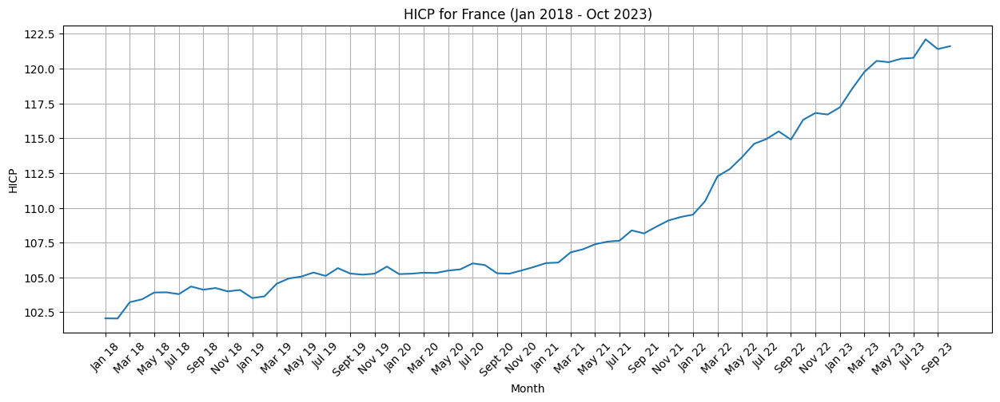

In [336]:
plt.figure(figsize=(15, 5))
plt.plot(df_HICP_FR['Month'], df_HICP_FR['HICP_France_2018-2023'])
plt.title('HICP for France (Jan 2018 - Oct 2023)')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP_FR['Month'][::2])
plt.grid(True)
plt.show()


In [337]:
summary_stats = df_HICP_FR['HICP_France_2018-2023'].describe()
print(summary_stats)


count     70.000000
mean     109.031714
std        5.906146
min      102.050000
25%      105.132500
50%      105.950000
75%      113.417500
max      122.100000
Name: HICP_France_2018-2023, dtype: float64


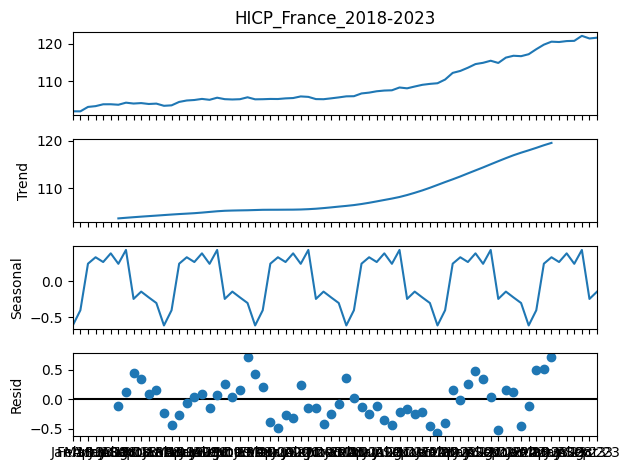

<Figure size 1500x500 with 0 Axes>

In [338]:
# Seasonal decomposition
result = seasonal_decompose(df_HICP_FR.set_index('Month')['HICP_France_2018-2023'], model='additive', period=12)

# Plot the decomposition
result.plot()
plt.figure(figsize=(15, 5))
plt.show()

### Exploration and merge of all inflation dataframes:

#### Clean

In [339]:
df_list_HICP = [df_HICP_FR, df_HICP_BE, df_HICP_BU_21, df_HICP_FI, df_HICP_GR, df_HICP_PO, df_HICP_RO, df_HICP_HU]
df_list_HICP_nrj = [df_HICP_food_europe, df_HICP_nrj_BU, df_HICP_nrj_GE, df_HICP_nrj_GR, df_HICP_nrj_IT]


for df in df_list_HICP:
   # Standardize date format
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("'", "").replace("*","").replace("Sept", "Sep").replace('2018', '18').replace('2019', '19').replace('2020', '20').replace('2021', '21').replace('2022', '22').replace('2023', '23'))
    # Rename the second column to 'HICP'
    df.rename(columns={df.columns[1]: 'HICP'}, inplace=True)
    # Drop the third and fourth columns if they exist
    if len(df.columns) > 2:
        df.drop(df.columns[2:], axis=1, inplace=True)

for i, df in enumerate(df_list_HICP):
    print(f"DataFrame {i+1}:")
    print(df)
    print()


DataFrame 1:
     Month    HICP
0   Jan 18  102.06
1   Feb 18  102.05
2   Mar 18  103.22
3   Apr 18  103.43
4   May 18  103.92
..     ...     ...
65  Jun 23  120.71
66  Jul 23  120.77
67  Aug 23  122.10
68  Sep 23  121.40
69  Oct 23  121.61

[70 rows x 2 columns]

DataFrame 2:
     Month  HICP
0   Jan 18   1.8
1   Feb 18   1.5
2   Mar 18   1.5
3   Apr 18   1.6
4   May 18   2.3
..     ...   ...
63  May 23   2.7
64  Jun 23   1.6
65  Jul 23   1.7
66  Aug 23   2.4
67  Sep 23   0.7

[68 rows x 2 columns]

DataFrame 3:
     Month  HICP
0   Jan 18  -0.3
1   Feb 18   0.2
2   Mar 18   0.8
3   Apr 18   2.0
4   May 18   2.3
5   Jun 18   2.4
6   Jul 18   2.2
7   Aug 18   2.5
8   Sep 18   4.0
9   Oct 18   5.2
10  Nov 18   6.3
11  Dec 18   6.6

DataFrame 4:
     Month    HICP
0   Jan 20  103.72
1   Feb 20  104.20
2   Mar 20  104.03
3   Apr 20  103.58
4   May 20  103.52
5   Jun 20  103.77
6   Jul 20  104.07
7   Aug 20  104.09
8   Sep 20  104.11
9   Oct 20  104.22
10  Nov 20  104.10
11  Dec 20  104.30

In [340]:
# correct some dates formatting issues

for df in df_list_HICP:
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("Sep22", "Sep 22").replace("Oct22","Oct 22").replace("Nov22", "Nov 22").replace('Dec22', 'Dec 22').replace('Jan23', 'Jan 23').replace('Feb23', 'Feb 23').replace('Mar23', 'Mar 23').replace('Apr23', 'Apr 23').replace('May23', 'May 23').replace('Jun23', 'Jun 23'))
   
   
for i, df in enumerate(df_list_HICP):
    print(f"DataFrame {i+1}:")
    print(df)
    print()

DataFrame 1:
     Month    HICP
0   Jan 18  102.06
1   Feb 18  102.05
2   Mar 18  103.22
3   Apr 18  103.43
4   May 18  103.92
..     ...     ...
65  Jun 23  120.71
66  Jul 23  120.77
67  Aug 23  122.10
68  Sep 23  121.40
69  Oct 23  121.61

[70 rows x 2 columns]

DataFrame 2:
     Month  HICP
0   Jan 18   1.8
1   Feb 18   1.5
2   Mar 18   1.5
3   Apr 18   1.6
4   May 18   2.3
..     ...   ...
63  May 23   2.7
64  Jun 23   1.6
65  Jul 23   1.7
66  Aug 23   2.4
67  Sep 23   0.7

[68 rows x 2 columns]

DataFrame 3:
     Month  HICP
0   Jan 18  -0.3
1   Feb 18   0.2
2   Mar 18   0.8
3   Apr 18   2.0
4   May 18   2.3
5   Jun 18   2.4
6   Jul 18   2.2
7   Aug 18   2.5
8   Sep 18   4.0
9   Oct 18   5.2
10  Nov 18   6.3
11  Dec 18   6.6

DataFrame 4:
     Month    HICP
0   Jan 20  103.72
1   Feb 20  104.20
2   Mar 20  104.03
3   Apr 20  103.58
4   May 20  103.52
5   Jun 20  103.77
6   Jul 20  104.07
7   Aug 20  104.09
8   Sep 20  104.11
9   Oct 20  104.22
10  Nov 20  104.10
11  Dec 20  104.30

In [341]:
# Add column location

locations = ['France', 'Belgium', 'Bulgaria', 'Finland', 'Greece', 'Poland', 'Romania', 'Hungary']

for i, df in enumerate(df_list_HICP):
    df['location'] = locations[i]

for i, df in enumerate(df_list_HICP):
    print(f"DataFrame {i+1}:")
    print(df)
    print()


DataFrame 1:
     Month    HICP location
0   Jan 18  102.06   France
1   Feb 18  102.05   France
2   Mar 18  103.22   France
3   Apr 18  103.43   France
4   May 18  103.92   France
..     ...     ...      ...
65  Jun 23  120.71   France
66  Jul 23  120.77   France
67  Aug 23  122.10   France
68  Sep 23  121.40   France
69  Oct 23  121.61   France

[70 rows x 3 columns]

DataFrame 2:
     Month  HICP location
0   Jan 18   1.8  Belgium
1   Feb 18   1.5  Belgium
2   Mar 18   1.5  Belgium
3   Apr 18   1.6  Belgium
4   May 18   2.3  Belgium
..     ...   ...      ...
63  May 23   2.7  Belgium
64  Jun 23   1.6  Belgium
65  Jul 23   1.7  Belgium
66  Aug 23   2.4  Belgium
67  Sep 23   0.7  Belgium

[68 rows x 3 columns]

DataFrame 3:
     Month  HICP  location
0   Jan 18  -0.3  Bulgaria
1   Feb 18   0.2  Bulgaria
2   Mar 18   0.8  Bulgaria
3   Apr 18   2.0  Bulgaria
4   May 18   2.3  Bulgaria
5   Jun 18   2.4  Bulgaria
6   Jul 18   2.2  Bulgaria
7   Aug 18   2.5  Bulgaria
8   Sep 18   4.0  Bulg

#### Merge

In [342]:
merged_df_inflation = pd.concat(df_list_HICP, ignore_index=True)

print(merged_df_inflation)


      Month    HICP location
0    Jan 18  102.06   France
1    Feb 18  102.05   France
2    Mar 18  103.22   France
3    Apr 18  103.43   France
4    May 18  103.92   France
..      ...     ...      ...
329  Mar 23  159.42  Hungary
330  Apr 23  160.57  Hungary
331  May 23  159.99  Hungary
332  Jun 23  160.55  Hungary
333  Jul 23  161.12  Hungary

[334 rows x 3 columns]


#### same for the others

In [343]:
for df in df_list_HICP_nrj:
   # Standardize date format
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("'", "").replace("*","").replace("Sept", "Sep").replace('2018', '18').replace('2019', '19').replace('2020', '20').replace('2021', '21').replace('2022', '22').replace('2023', '23'))
    # Rename the second column to 'HICP'
    df.rename(columns={df.columns[1]: 'HICP'}, inplace=True)
    # Drop the third and fourth columns if they exist
    if len(df.columns) > 2:
        df.drop(df.columns[2:], axis=1, inplace=True)

In [344]:
for df in df_list_HICP_nrj:
    df.iloc[:, 0] = df.iloc[:, 0].apply(lambda x: str(x).replace("Sep22", "Sep 22").replace("Oct22","Oct 22").replace("Nov22", "Nov 22").replace('Dec22', 'Dec 22').replace('Jan23', 'Jan 23').replace('Feb23', 'Feb 23').replace('Mar23', 'Mar 23').replace('Apr23', 'Apr 23').replace('May23', 'May 23').replace('Jun23', 'Jun 23'))


In [345]:
# add column location
locations_nrj = ['europe', 'Bulgaria', 'Germany', 'Greece', 'Italy']
for i, df in enumerate(df_list_HICP_nrj):
    df['location'] = locations_nrj[i]

In [346]:
for i, df in enumerate(df_list_HICP_nrj):
    print(f"DataFrame {i+1}:")
    print(df)
    print()

DataFrame 1:
     Month   HICP location
0   Jan 16   0.10   europe
1   Feb 16  -0.10   europe
2   Mar 15   0.00   europe
3   Apr 16  -0.10   europe
4   May 16  -0.10   europe
..     ...    ...      ...
89  Jun 23  13.81   europe
90  Jul 23  12.46   europe
91  Aug 23  10.68   europe
92  Sep 23   9.36   europe
93  Oct 23   7.59   europe

[94 rows x 3 columns]

DataFrame 2:
     Month  HICP  location
0   Jan 19   0.4  Bulgaria
1   Feb 19   1.7  Bulgaria
2   Mar 19   4.4  Bulgaria
3   Apr 19   4.8  Bulgaria
4   May 19   3.9  Bulgaria
5   Jun 19   1.2  Bulgaria
6   Jul 19   0.6  Bulgaria
7   Aug 19   0.1  Bulgaria
8   Sep 19  -0.8  Bulgaria
9   Oct 19  -2.6  Bulgaria
10  Nov 19  -0.5  Bulgaria
11  Dec 19   3.7  Bulgaria
12  Jan 20   5.8  Bulgaria
13  Feb 20   4.1  Bulgaria
14  Mar 20  -0.1  Bulgaria
15  Apr 20  -8.3  Bulgaria
16  May 20 -11.5  Bulgaria
17  Jun 20 -11.3  Bulgaria
18  Jul 20  -9.4  Bulgaria
19  Aug 20  -8.3  Bulgaria
20  Sep 20  -8.2  Bulgaria
21  Oct 20  -8.5  Bulgaria
22  N

In [347]:
merged_df_inflation_nrj = pd.concat(df_list_HICP_nrj, ignore_index=True)

print(merged_df_inflation_nrj)

      Month   HICP location
0    Jan 16    0.1   europe
1    Feb 16   -0.1   europe
2    Mar 15    0.0   europe
3    Apr 16   -0.1   europe
4    May 16   -0.1   europe
..      ...    ...      ...
300  Jan 23  197.0    Italy
301  Feb 23  188.2    Italy
302  Mar 23  171.4    Italy
303  Apr 23  170.1    Italy
304  May 23  167.8    Italy

[305 rows x 3 columns]


### Analyse inflation merged table

In [348]:
# Descriptive statistics
desc_stats = merged_df_inflation.groupby('location')['HICP'].describe()
print(desc_stats)


          count        mean        std     min       25%     50%       75%  \
location                                                                     
Belgium    68.0    3.525000   3.599518   -0.90    1.1500    2.15    5.0250   
Bulgaria   12.0    2.850000   2.250858   -0.30    1.7000    2.35    4.3000   
Finland    43.0  109.711163   5.799652  103.52  104.2600  107.14  114.8450   
France     70.0  109.031714   5.906146  102.05  105.1325  105.95  113.4175   
Greece     12.0    0.800000   0.430644    0.20    0.4750    0.80    1.0250   
Hungary    43.0  129.059302  17.431156  111.92  114.2450  121.38  143.5050   
Poland     43.0  121.572093  12.884955  106.90  109.6500  116.50  132.4000   
Romania    43.0  121.798605  11.170361  110.05  111.1350  117.85  131.3300   

             max  
location          
Belgium    13.10  
Bulgaria    6.60  
Finland   119.28  
France    122.10  
Greece      1.80  
Hungary   161.12  
Poland    144.20  
Romania   141.76  


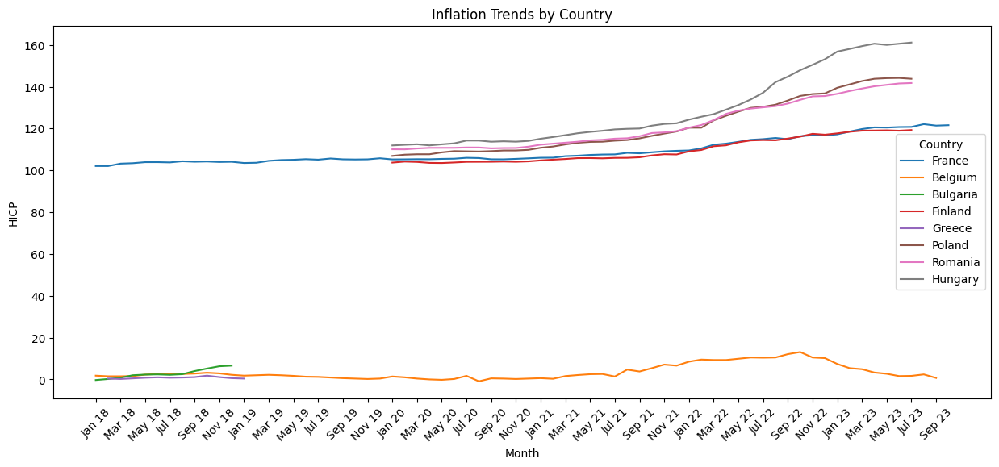

In [349]:
# Plot inflation trends
plt.figure(figsize=(15, 6))
sns.lineplot(data=merged_df_inflation, x='Month', y='HICP', hue='location')
plt.title('Inflation Trends by Country')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP_FR['Month'][::2])
plt.legend(title='Country')
plt.show()



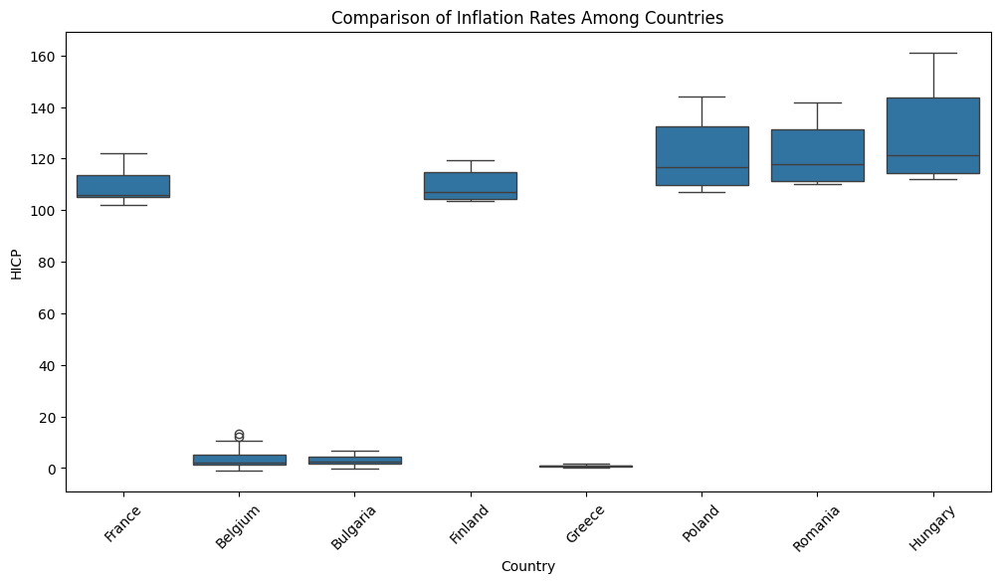

In [350]:
# Compare inflation among countries
plt.figure(figsize=(12, 6))
sns.boxplot(data=merged_df_inflation, x='location', y='HICP')
plt.title('Comparison of Inflation Rates Among Countries')
plt.xlabel('Country')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.show()


In [351]:
df_HICP = pd.concat([merged_df_inflation, merged_df_inflation_nrj], ignore_index=True)

# Print the concatenated dataframe
print(df_HICP)

      Month    HICP location
0    Jan 18  102.06   France
1    Feb 18  102.05   France
2    Mar 18  103.22   France
3    Apr 18  103.43   France
4    May 18  103.92   France
..      ...     ...      ...
634  Jan 23  197.00    Italy
635  Feb 23  188.20    Italy
636  Mar 23  171.40    Italy
637  Apr 23  170.10    Italy
638  May 23  167.80    Italy

[639 rows x 3 columns]


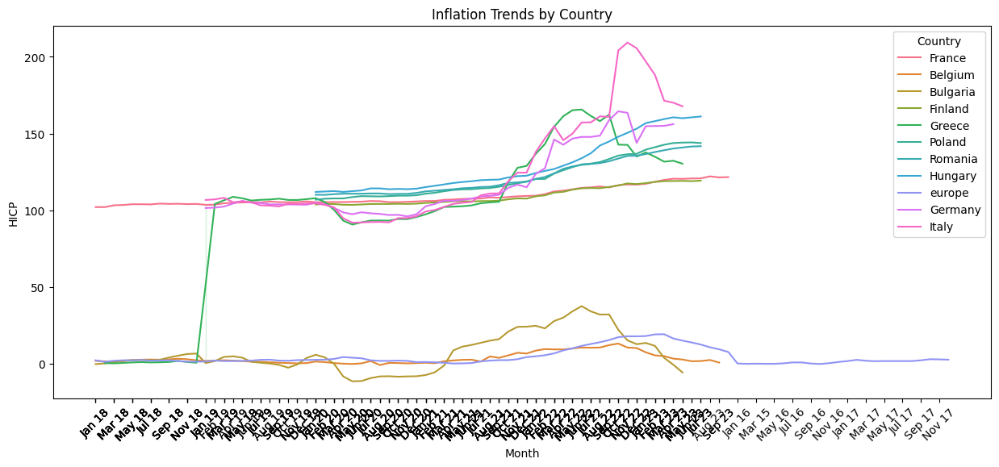

In [352]:
plt.figure(figsize=(15, 6))
sns.lineplot(data=df_HICP, x='Month', y='HICP', hue='location')
plt.title('Inflation Trends by Country')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP['Month'][::2])
plt.legend(title='Country')
plt.show()

In [353]:
# Descriptive statistics
desc_stats = df_HICP.groupby('location')['HICP'].describe()
print(desc_stats)

          count        mean        std     min       25%     50%       75%  \
location                                                                     
Belgium    68.0    3.525000   3.599518   -0.90    1.1500    2.15    5.0250   
Bulgaria   65.0    7.046154  12.722005  -11.50   -0.5000    3.80   13.6000   
Finland    43.0  109.711163   5.799652  103.52  104.2600  107.14  114.8450   
France     70.0  109.031714   5.906146  102.05  105.1325  105.95  113.4175   
Germany    52.0  117.746154  22.246784   96.00  102.5500  106.10  143.0000   
Greece     65.0   95.907846  50.013729    0.20   93.3000  105.42  130.3400   
Hungary    43.0  129.059302  17.431156  111.92  114.2450  121.38  143.5050   
Italy      53.0  124.750943  34.318170   91.90  102.5000  105.80  149.9000   
Poland     43.0  121.572093  12.884955  106.90  109.6500  116.50  132.4000   
Romania    43.0  121.798605  11.170361  110.05  111.1350  117.85  131.3300   
europe     94.0    4.340426   5.300106   -0.20    1.5250    2.15

In [354]:
from sklearn.preprocessing import StandardScaler

# Separate the data for France, Finland, and Germany
df_standardize_special = df_HICP[~df_HICP['location'].isin(['Belgium', 'Bulagaria', 'europe'])].copy()

# Separate the data for other countries
df_standardize_others = df_HICP[df_HICP['location'].isin(['Belgium', 'Bulagaria', 'europe'])].copy()

# Create a StandardScaler object
scaler = StandardScaler()

# Standardize the 'HICP' column for France, Finland, and Germany
df_standardize_special.loc[:, 'HICP'] = scaler.fit_transform(df_standardize_special[['HICP']])

# Standardize the 'HICP' column for the other countries
df_standardize_others.loc[:, 'HICP'] = scaler.fit_transform(df_standardize_others[['HICP']])

# Concatenate the two dataframes back together
df_HICP_std = pd.concat([df_standardize_special, df_standardize_others])

# Sort the dataframe by index to maintain the original order
df_HICP_std = df_HICP_std.sort_index()

# Print the standardized dataframe
print(df_HICP_std)


      Month      HICP location
0    Jan 18  0.041164   France
1    Feb 18  0.040944   France
2    Mar 18  0.066707   France
3    Apr 18  0.071331   France
4    May 18  0.082121   France
..      ...       ...      ...
634  Jan 23  2.131702    Italy
635  Feb 23  1.937930    Italy
636  Mar 23  1.568001    Italy
637  Apr 23  1.539376    Italy
638  May 23  1.488731    Italy

[639 rows x 3 columns]


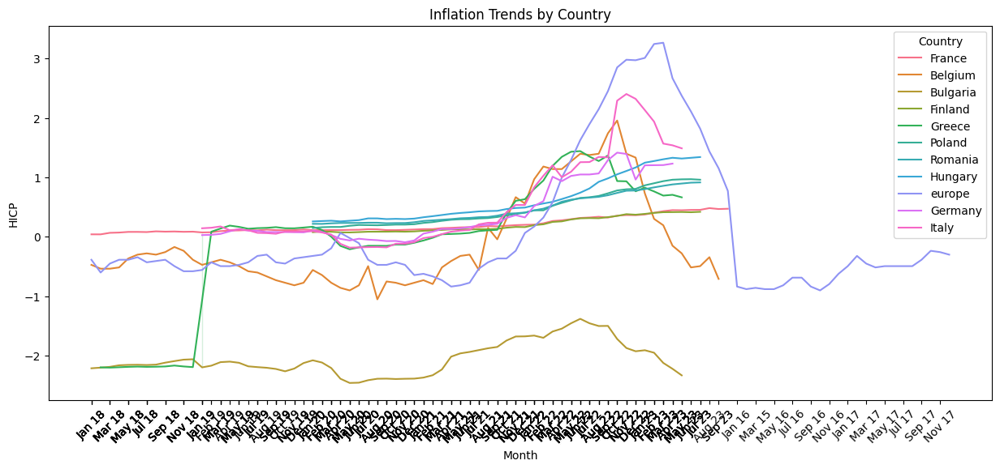

In [355]:
# Plot inflation trends
plt.figure(figsize=(15, 6))
sns.lineplot(data=df_HICP_std, x='Month', y='HICP', hue='location')
plt.title('Inflation Trends by Country')
plt.xlabel('Month')
plt.ylabel('HICP')
plt.xticks(rotation=45)
plt.xticks(df_HICP_std['Month'][::2])
plt.legend(title='Country')
plt.show()

Removing Bulgaria, Greece and Norway is still a good option

### Merge covid and inflation tables

#### clean

In [356]:
df_HICP_std.rename(columns={'Month': 'date'}, inplace=True)

In [357]:
# Convert 'date' column to datetime
df_covid_europe_8countries_4features['date'] = pd.to_datetime(df_covid_europe_8countries_4features['date'])

df_HICP_std['date'] = pd.to_datetime(df_HICP_std['date'], format='%b %y')


/tmp/ipykernel_7616/688332743.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/tmp/ipykernel_7616/1256728659.py:10: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



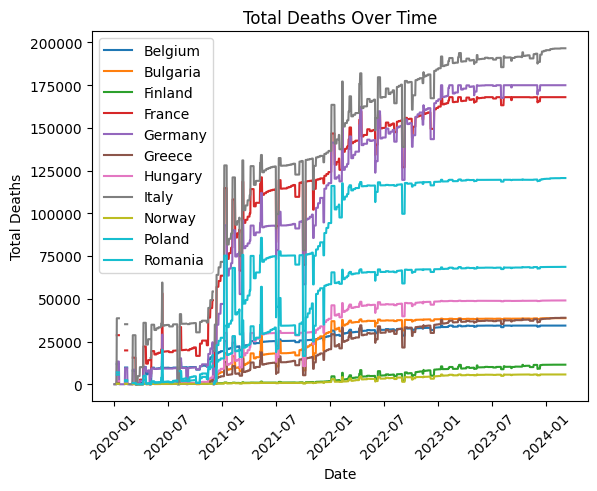

In [358]:
fig, ax = plt.subplots()

unique_countries = df_covid_europe_8countries_4features['location'].unique()

color_map = plt.cm.get_cmap('tab10', len(unique_countries))

for i, country in enumerate(unique_countries):
    country_data = df_covid_europe_8countries_4features[df_covid_europe_8countries_4features['location'] == country]
    ax.plot(country_data['date'], country_data['total_deaths'], linestyle='-', label=country, color=color_map(i))

ax.set_title('Total Deaths Over Time')
ax.set_xlabel('Date')
ax.set_ylabel('Total Deaths')

plt.xticks(rotation=45)

ax.legend()

plt.show()


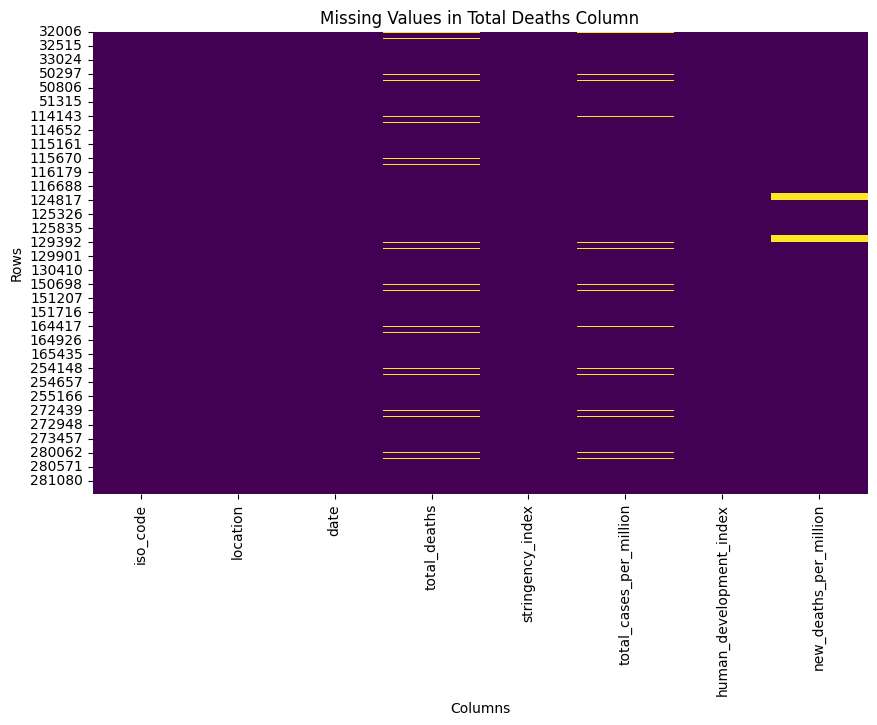

In [359]:
# Create a heatmap to visualize missing values
plt.figure(figsize=(10, 6))
sns.heatmap(df_covid_europe_8countries_4features.isnull(), cmap='viridis', cbar=False)
plt.title('Missing Values in Total Deaths Column')
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()


In [360]:
# Get the unique dates with missing values in the total_deaths column
missing_dates = df_covid_europe_8countries_4features[df_covid_europe_8countries_4features['total_deaths'].isnull()]['date'].unique()

print(missing_dates)


<DatetimeArray>
['2020-01-03 00:00:00', '2020-01-04 00:00:00', '2020-01-05 00:00:00',
 '2020-01-06 00:00:00', '2020-01-07 00:00:00', '2020-01-08 00:00:00',
 '2020-01-09 00:00:00', '2020-01-10 00:00:00', '2020-01-19 00:00:00',
 '2020-01-20 00:00:00', '2020-01-21 00:00:00', '2020-01-22 00:00:00',
 '2020-01-23 00:00:00', '2020-01-24 00:00:00', '2020-01-25 00:00:00',
 '2020-01-26 00:00:00', '2020-01-27 00:00:00', '2020-01-28 00:00:00',
 '2020-01-29 00:00:00', '2020-01-30 00:00:00', '2020-01-31 00:00:00',
 '2020-02-01 00:00:00', '2020-02-02 00:00:00', '2020-02-03 00:00:00',
 '2020-02-04 00:00:00', '2020-02-05 00:00:00', '2020-02-06 00:00:00',
 '2020-02-07 00:00:00', '2020-02-16 00:00:00', '2020-02-17 00:00:00',
 '2020-02-18 00:00:00', '2020-02-19 00:00:00', '2020-02-20 00:00:00',
 '2020-02-21 00:00:00', '2020-02-22 00:00:00', '2020-02-23 00:00:00',
 '2020-02-24 00:00:00', '2020-02-25 00:00:00', '2020-02-26 00:00:00',
 '2020-02-27 00:00:00', '2020-02-28 00:00:00', '2020-02-29 00:00:00',
 '20

Removing the missing values before may 2020 by 0 and the ones after that date by the value of the day before

In [361]:

missing_index = df_covid_europe_8countries_4features[(df_covid_europe_8countries_4features['total_deaths'].isnull()) & 
                                                     (df_covid_europe_8countries_4features['date'] <= '2020-05-03')].index

df_covid_europe_8countries_4features.loc[missing_index, 'total_deaths'] = 0

df_covid_europe_8countries_4features['total_deaths'] = df_covid_europe_8countries_4features['total_deaths'].fillna(method='ffill')

df_covid_europe_8countries_4features


/tmp/ipykernel_7616/1366552587.py:9: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

/tmp/ipykernel_7616/1366552587.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
32006,BEL,Belgium,2020-01-03,0.0,0.0,0.086,0.931,0.0
32007,BEL,Belgium,2020-01-04,0.0,0.0,0.086,0.931,0.0
32008,BEL,Belgium,2020-01-05,0.0,0.0,0.086,0.931,0.0
32009,BEL,Belgium,2020-01-06,0.0,0.0,0.086,0.931,0.0
32010,BEL,Belgium,2020-01-07,0.0,0.0,0.086,0.931,0.0
...,...,...,...,...,...,...,...,...
281551,ROU,Romania,2024-03-01,68697.0,0.0,179225.271,0.828,0.0
281552,ROU,Romania,2024-03-02,68697.0,0.0,179225.271,0.828,0.0
281553,ROU,Romania,2024-03-03,68697.0,0.0,179225.271,0.828,0.0
281554,ROU,Romania,2024-03-04,68697.0,0.0,179225.271,0.828,0.0


In [362]:
# Get the unique dates with missing values in the total_cases_per_million column
missing_dates = df_covid_europe_8countries_4features[df_covid_europe_8countries_4features['total_cases_per_million'].isnull()]['date'].unique()

print(missing_dates)


<DatetimeArray>
['2020-01-19 00:00:00', '2020-01-20 00:00:00', '2020-01-21 00:00:00',
 '2020-01-22 00:00:00', '2020-01-23 00:00:00', '2020-01-24 00:00:00',
 '2020-01-25 00:00:00', '2020-01-26 00:00:00', '2020-01-27 00:00:00',
 '2020-01-28 00:00:00', '2020-01-29 00:00:00', '2020-01-30 00:00:00',
 '2020-01-31 00:00:00', '2020-02-01 00:00:00', '2020-02-02 00:00:00',
 '2020-02-03 00:00:00', '2020-02-04 00:00:00', '2020-02-05 00:00:00',
 '2020-02-06 00:00:00', '2020-02-07 00:00:00', '2020-05-01 00:00:00',
 '2020-05-02 00:00:00', '2020-05-03 00:00:00', '2020-12-01 00:00:00',
 '2020-12-02 00:00:00', '2020-12-03 00:00:00', '2020-01-03 00:00:00',
 '2020-01-04 00:00:00', '2020-01-05 00:00:00', '2020-01-06 00:00:00',
 '2020-01-07 00:00:00', '2020-01-08 00:00:00', '2020-01-09 00:00:00',
 '2020-01-10 00:00:00', '2020-02-16 00:00:00', '2020-02-17 00:00:00',
 '2020-02-18 00:00:00', '2020-02-19 00:00:00', '2020-02-20 00:00:00',
 '2020-02-21 00:00:00', '2020-02-22 00:00:00', '2020-02-23 00:00:00',
 '20

In [363]:
missing_index = df_covid_europe_8countries_4features[(df_covid_europe_8countries_4features['total_cases_per_million'].isnull()) & 
                                                     (df_covid_europe_8countries_4features['date'] <= '2020-05-03')].index

df_covid_europe_8countries_4features.loc[missing_index, 'total_cases_per_million'] = 0

df_covid_europe_8countries_4features['total_cases_per_million'] = df_covid_europe_8countries_4features['total_cases_per_million'].fillna(method='ffill')

df_covid_europe_8countries_4features


/tmp/ipykernel_7616/186452168.py:9: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

/tmp/ipykernel_7616/186452168.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
32006,BEL,Belgium,2020-01-03,0.0,0.0,0.086,0.931,0.0
32007,BEL,Belgium,2020-01-04,0.0,0.0,0.086,0.931,0.0
32008,BEL,Belgium,2020-01-05,0.0,0.0,0.086,0.931,0.0
32009,BEL,Belgium,2020-01-06,0.0,0.0,0.086,0.931,0.0
32010,BEL,Belgium,2020-01-07,0.0,0.0,0.086,0.931,0.0
...,...,...,...,...,...,...,...,...
281551,ROU,Romania,2024-03-01,68697.0,0.0,179225.271,0.828,0.0
281552,ROU,Romania,2024-03-02,68697.0,0.0,179225.271,0.828,0.0
281553,ROU,Romania,2024-03-03,68697.0,0.0,179225.271,0.828,0.0
281554,ROU,Romania,2024-03-04,68697.0,0.0,179225.271,0.828,0.0


#### Merge inflation and covid table 

In [364]:
df_covid_europe_8countries_4features.head()

,iso_code,location,date,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
32006,BEL,Belgium,2020-01-03,0.0,0.0,0.086,0.931,0.0
32007,BEL,Belgium,2020-01-04,0.0,0.0,0.086,0.931,0.0
32008,BEL,Belgium,2020-01-05,0.0,0.0,0.086,0.931,0.0
32009,BEL,Belgium,2020-01-06,0.0,0.0,0.086,0.931,0.0
32010,BEL,Belgium,2020-01-07,0.0,0.0,0.086,0.931,0.0


In [365]:
# Step 1: Aggregate COVID data by month, taking the median value for numeric features
numeric_columns = ['total_deaths', 'stringency_index', 'total_cases_per_million', 'human_development_index', 'new_deaths_per_million']
df_covid_monthly = df_covid_europe_8countries_4features.groupby([pd.Grouper(key='date', freq='ME'), 'location'])[numeric_columns].median().reset_index()

In [366]:
df_covid_monthly

,date,location,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
0,2020-01-31,Belgium,0.0,0.0,0.086,0.931,0.0
1,2020-01-31,Bulgaria,0.0,0.0,0.000,0.816,0.0
2,2020-01-31,Finland,0.0,0.0,1.444,0.938,0.0
3,2020-01-31,France,0.0,0.0,0.248,0.901,0.0
4,2020-01-31,Germany,11.0,0.0,2.039,0.947,0.0
...,...,...,...,...,...,...,...
556,2024-03-31,Hungary,49045.0,0.0,223740.943,0.854,0.0
557,2024-03-31,Italy,196592.0,0.0,452455.823,0.892,0.0
558,2024-03-31,Norway,5732.0,0.0,277245.339,0.957,0.0
559,2024-03-31,Poland,120665.0,0.0,167067.967,0.880,0.0


In [369]:
# Step 2: Convert 'date' column to month and year
df_HICP_std['date'] = df_HICP_std['date'].dt.to_period('M')
df_covid_monthly['date'] = df_covid_monthly['date'].dt.to_period('M')

# Step 3: Merge aggregated COVID data with inflation data based on 'location' and 'date' (month and year)
df_covid_HICP = pd.merge(df_HICP_std, df_covid_monthly, on=['location', 'date'], how='inner')

df_covid_HICP

,date,HICP,location,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
0,2020-01,0.111186,France,0.0,0.00,0.248,0.901,0.0
1,2020-02,0.111847,France,0.0,5.56,0.248,0.901,0.0
2,2020-03,0.113388,France,713.0,56.94,0.248,0.901,0.0
3,2020-04,0.112948,France,12062.0,87.96,0.248,0.901,0.0
4,2020-05,0.116691,France,17992.0,76.85,77.878,0.901,0.0
...,...,...,...,...,...,...,...,...
421,2023-01,2.131702,Italy,186158.0,0.00,429911.498,0.892,0.0
422,2023-02,1.937930,Italy,189155.0,0.00,435336.171,0.892,0.0
423,2023-03,1.568001,Italy,188974.0,0.00,434980.482,0.892,0.0
424,2023-04,1.539376,Italy,189627.0,0.00,436544.082,0.892,0.0


In [370]:
# Remove Norway, Greece and Bulgaria
selected_countries = ['Belgium', 'Finland', 'Italy', 'France', 'Germany', 'Poland', 'Romania', 'Hungary']

df_covid_HICP = df_covid_HICP[df_covid_HICP['location'].isin(selected_countries)]

df_covid_HICP

,date,HICP,location,total_deaths,stringency_index,total_cases_per_million,human_development_index,new_deaths_per_million
0,2020-01,0.111186,France,0.0,0.00,0.248,0.901,0.0
1,2020-02,0.111847,France,0.0,5.56,0.248,0.901,0.0
2,2020-03,0.113388,France,713.0,56.94,0.248,0.901,0.0
3,2020-04,0.112948,France,12062.0,87.96,0.248,0.901,0.0
4,2020-05,0.116691,France,17992.0,76.85,77.878,0.901,0.0
...,...,...,...,...,...,...,...,...
421,2023-01,2.131702,Italy,186158.0,0.00,429911.498,0.892,0.0
422,2023-02,1.937930,Italy,189155.0,0.00,435336.171,0.892,0.0
423,2023-03,1.568001,Italy,188974.0,0.00,434980.482,0.892,0.0
424,2023-04,1.539376,Italy,189627.0,0.00,436544.082,0.892,0.0


## Exploration of other economic tables

### Preprocess the tables

In [371]:
df_education = pd.read_csv('Data/Education-GDP.csv', delimiter=',')
df_GDP = pd.read_csv('Data/GDP.csv', delimiter=',')
df_gini = pd.read_csv('Data/gini.csv', delimiter=',')
df_poverty = pd.read_csv('Data/poverty-explorer.csv', delimiter=',')
df_trade = pd.read_csv('Data/trade.csv', delimiter=',')


selected_countries = ['Belgium', 'Finland', 'Italy', 'France', 'Germany', 'Poland', 'Romania', 'Hungary']

def preprocess_dataframe(df):
    # Replace "Country" or "Entity" with "location"
    df.rename(columns={'Country': 'location', 'Entity': 'location'}, inplace=True)
    
    # Convert "Year" to datetime and rename it to "date"
    df['date'] = pd.to_datetime(df['Year'], format='%Y')
    df.drop(columns=['Year'], inplace=True)

    # Drop the "Code" column
    if 'Code' in df.columns:
        df.drop(columns=['Code'], inplace=True)

    # Select only rows concerning selected countries and after 2017
    df = df[(df['location'].isin(selected_countries)) & (df['date'].dt.year >= 2017)]
    
    return df

df_education = preprocess_dataframe(df_education)
df_GDP = preprocess_dataframe(df_GDP)
df_gini = preprocess_dataframe(df_gini)
df_poverty = preprocess_dataframe(df_poverty)
df_trade = preprocess_dataframe(df_trade)



In [372]:
df_education.rename(columns={df_education.columns[1]: 'education'}, inplace=True)
df_education

,location,education,date
478,Belgium,6.425340,2017-01-01
479,Belgium,6.381070,2018-01-01
480,Belgium,6.333970,2019-01-01
481,Belgium,6.812330,2020-01-01
482,Belgium,6.234233,2021-01-01
1683,Finland,6.363110,2017-01-01
1684,Finland,6.275580,2018-01-01
1685,Finland,6.416950,2019-01-01
1686,Finland,6.634940,2020-01-01
1687,Finland,5.693809,2021-01-01


In [373]:
df_GDP.rename(columns={df_GDP.columns[1]: 'GDP'}, inplace=True)
df_GDP.drop(columns=[df_GDP.columns[2]], inplace=True)
df_GDP = df_GDP[df_GDP['date'].dt.year <= 2022]
df_GDP

,location,GDP,date
771,Belgium,1.620,2017-01-01
772,Belgium,1.793,2018-01-01
773,Belgium,2.262,2019-01-01
774,Belgium,-5.363,2020-01-01
775,Belgium,6.286,2021-01-01
776,Belgium,3.248,2022-01-01
2748,Finland,3.192,2017-01-01
2749,Finland,1.140,2018-01-01
2750,Finland,1.224,2019-01-01
2751,Finland,-2.355,2020-01-01


In [374]:
df_gini.rename(columns={df_gini.columns[1]: 'gini'}, inplace=True)
df_gini

,location,gini,date
172,Belgium,0.273880,2017-01-01
173,Belgium,0.272144,2018-01-01
174,Belgium,0.272198,2019-01-01
175,Belgium,0.259583,2020-01-01
739,Finland,0.273831,2017-01-01
740,Finland,0.273298,2018-01-01
741,Finland,0.277373,2019-01-01
742,Finland,0.270912,2020-01-01
769,France,0.316321,2017-01-01
770,France,0.323807,2018-01-01


In [375]:
# Renaming columns

relevant_columns = ['location', 'date', 'Median income or consumption per day', 
                    'Threshold income or consumption per day marking the poorest decile', 
                    'Threshold income or consumption per day marking the richest decile']

df_poverty = df_poverty[relevant_columns].copy()

df_poverty.rename(columns={'Median income or consumption per day': 'median_income',
                                     'Threshold income or consumption per day marking the poorest decile': 'poorest_decile_threshold',
                                     'Threshold income or consumption per day marking the richest decile': 'richest_decile_threshold'},
                           inplace=True)
df_poverty

,location,date,median_income,poorest_decile_threshold,richest_decile_threshold
172,Belgium,2017-01-01,50.106460,25.195316,89.483215
173,Belgium,2018-01-01,51.246574,26.038218,90.039635
174,Belgium,2019-01-01,52.628468,27.698778,93.140700
175,Belgium,2020-01-01,53.040030,28.693867,91.954960
827,Finland,2017-01-01,49.616215,28.033659,90.452280
828,Finland,2018-01-01,50.388140,28.374876,91.765030
829,Finland,2019-01-01,51.262200,28.351320,92.979256
830,Finland,2020-01-01,51.208990,29.307734,92.387900
857,France,2017-01-01,49.441666,24.629000,94.996870
858,France,2018-01-01,49.589756,24.751944,96.168710


In [376]:
df_trade.rename(columns={df_trade.columns[1]: 'trade'}, inplace=True)
df_trade

,location,trade,date
733,Belgium,165.325840,2017-01-01
734,Belgium,166.494780,2018-01-01
735,Belgium,164.176910,2019-01-01
736,Belgium,157.180730,2020-01-01
737,Belgium,172.674450,2021-01-01
3016,Finland,75.053140,2017-01-01
3017,Finland,78.192170,2018-01-01
3018,Finland,79.605430,2019-01-01
3019,Finland,71.634120,2020-01-01
3020,Finland,78.604590,2021-01-01


### Merge the tables

In [377]:
merged_df = df_education.merge(df_GDP, on=['location', 'date'], how='outer')

merged_df = merged_df.merge(df_gini, on=['location', 'date'], how='outer')

merged_df = merged_df.merge(df_poverty, on=['location', 'date'], how='outer')

df_economics = merged_df.merge(df_trade, on=['location', 'date'], how='outer')

df_economics


,location,education,date,GDP,gini,median_income,poorest_decile_threshold,richest_decile_threshold,trade
0,Belgium,6.425340,2017-01-01,1.620,0.273880,50.106460,25.195316,89.483215,165.325840
1,Belgium,6.381070,2018-01-01,1.793,0.272144,51.246574,26.038218,90.039635,166.494780
2,Belgium,6.333970,2019-01-01,2.262,0.272198,52.628468,27.698778,93.140700,164.176910
3,Belgium,6.812330,2020-01-01,-5.363,0.259583,53.040030,28.693867,91.954960,157.180730
4,Belgium,6.234233,2021-01-01,6.286,NaN,NaN,NaN,NaN,172.674450
5,Belgium,NaN,2022-01-01,3.248,NaN,NaN,NaN,NaN,NaN
6,Finland,6.363110,2017-01-01,3.192,0.273831,49.616215,28.033659,90.452280,75.053140
7,Finland,6.275580,2018-01-01,1.140,0.273298,50.388140,28.374876,91.765030,78.192170
8,Finland,6.416950,2019-01-01,1.224,0.277373,51.262200,28.351320,92.979256,79.605430
9,Finland,6.634940,2020-01-01,-2.355,0.270912,51.208990,29.307734,92.387900,71.634120


## Addition of features

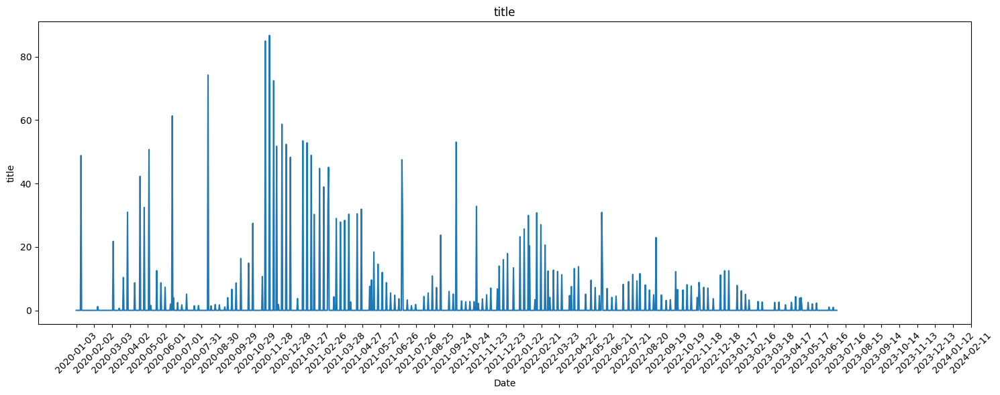

In [390]:
df_country = df_covid[df_covid['location'] == 'France']

plt.figure(figsize=(15, 6))
plt.plot(df_country['date'], df_country['new_deaths_per_million'], linestyle='-')
plt.title('title')
plt.xlabel('Date')
plt.ylabel('title')
plt.xticks(rotation=45)  
plt.xticks(df_country['date'][::30])
plt.tight_layout()
plt.show()


In [385]:
df_new_deaths = df_covid[df_covid['location']=='France']['new_deaths_per_million']
df_new_deaths.head(50)


115661     0.000
115662     0.000
115663     0.000
115664     0.000
115665     0.000
115666     0.000
115667     0.000
115668     0.000
115669    48.803
115670     0.000
115671     0.000
115672     0.000
115673     0.000
115674     0.000
115675     0.000
115676     0.000
115677     0.000
115678     0.000
115679     0.000
115680     0.000
115681     0.000
115682     0.000
115683     0.000
115684     0.000
115685     0.000
115686     0.000
115687     0.000
115688     0.000
115689     0.000
115690     0.000
115691     0.000
115692     0.000
115693     0.000
115694     0.000
115695     0.000
115696     0.000
115697     1.191
115698     0.000
115699     0.000
115700     0.000
115701     0.000
115702     0.000
115703     0.000
115704     0.000
115705     0.000
115706     0.000
115707     0.000
115708     0.000
115709     0.000
115710     0.000
Name: new_deaths_per_million, dtype: float64